<a href="https://colab.research.google.com/github/apothula/dl/blob/main/Seg/08_DeepLabv3%2B_CamVid_512_Dice_Loss_4Concats.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<h1 style="font-size:30px;">Semantic Segmentation using DeepLabV3+ (CamVid Dataset)</h1>


## Modified DeepLabV3+ Architecture

In this notebook, we will modify the original DeepLabV3+ architecture and train it on the CamVid dataset. Notice the input image size used is now 512 x 512. In the figure below, `a`, `b`, `c`, and `d` refer to intermediate layers from the ResNet50 backbone that are extracted and processed in separate pipelines to achieve the final segmentation map.

<img src='https://opencv.org/wp-content/uploads/2022/07/c4-05-deeplabv3-4concat-camvid-512-feature-image.png' align='center' width='1000'>

## Modifications:

In this notebook, we will use a **modified DeepLabV3+** architecture to improve the segmentation quality. In this notebook, we will use a **modified DeepLabV3+** architecture to improve the segmentation quality. The modifications are summarized below:

1. An increased input image size of (512 x 512)
2. Two additional intermediate layers are extracted from the ResNet50 backbone
3. Dropout layer added in each convolutional block
4. A lower learning rate of .00005

## Table of Contents

* [1 System Configuration](#1-System-Configuration)
* [2 Training and Dataset Configurations](#2-Training-and-Dataset-Configurations)
* [3 Modeling DeepLabv3+ with a ResNet50 Backbone](#3-Modeling-DeepLabv3+-with-a-ResNet50-Backbone)
* [4 Dataset Preparation](#4-Dataset-Preparation)
* [5 Custom Data Loader Class](#5-Custom-Data-Loader-Class)
* [6 Helper Functions and Utilities](#6-Helper-Functions-and-Utilities)
* [7 Using the Custom Data Loader Class](#7-Using-the-Custom-Data-Loader-Class)
* [8_Custom Accuracy Metric](#8-Custom-Accuracy-Metric)
* [9_Custom Loss Function](#9-Custom-Loss-Function)
* [10 Compile and Train the Model](#10-Compile-and-Train-the-Model)
* [11 Plot the Training Results](#11-Plot-the-Training-Results)
* [12 Perform Inference](#12-Perform-Inference)
* [13 Conclusion](#13-Conclusion)

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import os
import sys
import cv2
import glob as glob
import albumentations as A
import requests
import zipfile

import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.utils import Sequence
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.layers import (Input, Conv2D, MaxPooling2D, AveragePooling2D,
                                     Conv2DTranspose, BatchNormalization, Activation,
                                     Dropout, UpSampling2D, Concatenate)
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input

from matplotlib.ticker import (MultipleLocator, FormatStrFormatter)
from dataclasses import dataclass
from tensorflow.python.ops.numpy_ops import np_config
np_config.enable_numpy_behavior()

block_plot = False
plt.rcParams['image.cmap'] = 'gray'

## 1 System Configuration

In [ ]:
def system_config(SEED_VALUE):

    np.random.seed(SEED_VALUE)
    tf.random.set_seed(SEED_VALUE)

    # Get list of GPUs.
    gpu_devices = tf.config.list_physical_devices('GPU')
    print(gpu_devices)

    if len(gpu_devices) > 0:

        os.environ["CUDA_VISIBLE_DEVICES"] = '0'
        os.environ['TF_CUDNN_DETERMINISTIC'] = '1'

        # If there are any gpu devices, use first gpu.
        tf.config.experimental.set_visible_devices(gpu_devices[0], 'GPU')

        # Grow the memory usage as it is needed by the process.
        tf.config.experimental.set_memory_growth(gpu_devices[0], True)

        # Enable using cudNN.
        os.environ['TF_USE_CUDNN'] = "true"
    else:
        print('Using CPU')

system_config(7)

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


## 2 Training and Dataset Configurations

Notice that we are now using an input image size of 512 x 512. However, due to the increased image size, we need to scale back on the number of images in each batch. The batch size has been reduced from 8 to 4 as shown below.

In [ ]:
@dataclass(frozen=True)
class DatasetConfig:
    NUM_CLASSES: int = 32
    IMG_WIDTH:   int = 512
    IMG_HEIGHT:  int = 512
    DATA_TRAIN_IMAGES: str = 'dataset_camvid_segmentation/train/*.png'
    DATA_TRAIN_LABELS: str = 'dataset_camvid_segmentation/train_labels/*.png'
    DATA_VALID_IMAGES: str = 'dataset_camvid_segmentation/val/*.png'
    DATA_VALID_LABELS: str = 'dataset_camvid_segmentation/val_labels/*.png'
    DATA_TEST_IMAGES:  str = 'dataset_camvid_segmentation/test/*.png'
    DATA_TEST_LABELS:  str = 'dataset_camvid_segmentation/test_labels/*.png'

@dataclass(frozen=True)
class TrainingConfig:
    BATCH_SIZE:      int = 4
    EPOCHS:          int = 101
    LEARNING_RATE: float = 0.00005
    CHECKPOINT_DIR:  str = 'model_checkpoint/DeepLab_CamVid'

@dataclass(frozen=True)
class InferenceConfig:
    NUM_BATCHES:     int = 6

## 3 Modeling DeepLabv3+ with a ResNet50 Backbone

### 3.1 `convolution_block()`

To build a model of DeepLabV3+ it is helpful to construct it from modular code. Since we will make use of a general convolutional block several times, let's define a function that implements this repeated pattern with several optional arguments for convenience. **Notice that we have added a dropout  layer to this function**.

In [ ]:
def convolution_block(block_input,
                      num_filters=256,
                      kernel_size=3,
                      dilation_rate=1,
                      padding="same",
                      use_bias=False):

    x = Conv2D(num_filters, kernel_size=kernel_size,
               dilation_rate=dilation_rate, padding="same", use_bias=use_bias)(block_input)

    x = BatchNormalization()(x)

    x = Dropout(0.2)(x)

    return Activation('relu')(x)

### 3.2 `DilatedSpatialPyramidPooling()`

The function below captures all the operations for Artrous (dilated) Spatial Pyramid Pooling as implemented in DeepLabV3+. Global average pooling is first performed on the input feature map to create a 1x1 feature map, followed by a 1x1 convolution to reduce the number of channels to 256, and finally, 2D upsampling to match the spatial dimensions of the input feature map. The input feature map is then also convolved four times with different dilation rates. All five outputs are concatenated together and passed through another 1x1 convolution operation to reduce the number of channels to 256. This final concatenated output is then passed to the encoder module for additional processing.

In [ ]:
def DilatedSpatialPyramidPooling(dspp_input):

    dims = dspp_input.shape

    # Create a 1x1 feature map using AveragePooling2D.
    x = AveragePooling2D(pool_size=(dims[1], dims[2]))(dspp_input)
    x = convolution_block(x, kernel_size=1, use_bias=True)

    # Upsample the feature map to the original size.
    out_pool = UpSampling2D(size=(dims[1], dims[2]), interpolation="bilinear")(x)

    # Create feature maps of the same shape with different dilation rates.
    out_1  = convolution_block(dspp_input, kernel_size=1, dilation_rate=1)
    out_6  = convolution_block(dspp_input, kernel_size=3, dilation_rate=6)
    out_12 = convolution_block(dspp_input, kernel_size=3, dilation_rate=12)
    out_18 = convolution_block(dspp_input, kernel_size=3, dilation_rate=18)

    # Combine all the feature maps and process them through a 1x1 convolutional block.
    x = Concatenate(axis=-1)([out_pool, out_1, out_6, out_12, out_18])
    output = convolution_block(x, kernel_size=1)

    return output

### 3.3 Architectural Changes
Let's now review the changes in this modified architecture. First, notice that the input shape to the network is now (512 x 512 x 3), and the output shape that the network produces is (512 x 512 x 32). The output from the network has the same spatial shape as the input with a depth of 32, which represents the number of classes in the dataset.

In this modified architecture, we extract four different intermediate feature maps from the ResNet50 backbone, which we refer to in the diagram and the code as `a`, `b`, `c`, and `d`. The lower resolution feature maps, `a` and `b`, are processed through the spatial pyramid pooling module, and the higher resolution feature maps, `c` and `d`, are processed separately as shown in the figure below. After all four sets of feature maps have been upsampled to a size of (256 x 256), they are concatenated together prior to the final layers in the network, which include two convolutional layers and a final upsampling to achieve the final segmentation map.

<img src="https://opencv.org/wp-content/uploads/2022/07/c4-05-deeplabv3-4concat-512-architecture-with-shapes.png" width=1000>

### 3.4 `deeplabv3plus()`

This is the main function that creates the DeepLabV3+ model based on the previous functions defined above.

In [ ]:
def deeplabv3plus(num_classes, shape):

    model_input = Input(shape=shape)
    preprocessing = preprocess_input(model_input)
    backbone = ResNet50(weights="imagenet", include_top=False, input_tensor=preprocessing)

    # Set all layers in the backbone as trainable.
    for layer in backbone.layers:
        layer.trainable = True

    # Obtain a (lower resolution) feature map from the backbone.
    # Shape: (16, 16, 512)
    input_a = backbone.get_layer('conv5_block3_2_relu').output

    # Pass through Atrous Spatial Pooling to obtain the best features at various scales.
    input_a = DilatedSpatialPyramidPooling(input_a)

    # Upsample the concatenated features.
    input_a = UpSampling2D(size=(16, 16), interpolation="bilinear")(input_a)

    # Obtain a second (lower resolution) feature map from the backbone.
    # Shape: (32, 32, 256)
    input_b = backbone.get_layer("conv4_block6_2_relu").output

    # Pass through Atrous Spatial Pooling to obtain the best features at various scales.
    input_b = DilatedSpatialPyramidPooling(input_b)

    # Upsample the concatenated features.
    input_b = UpSampling2D(size=(8, 8), interpolation="bilinear")(input_b)

    # Obtain a third (higher resolution) feature map from the backbone and apply convolution.
    # Shape: (128, 128, 64)
    input_c = backbone.get_layer("conv2_block3_2_relu").output
    input_c = convolution_block(input_c, num_filters=256, kernel_size=1)
    input_c = UpSampling2D((2, 2), interpolation='bilinear')(input_c)

    # Obtain a fourth (higher resolution) feature map from the backbone and apply convolution.
    # Shape: (256, 256, 64)
    input_d = backbone.get_layer("conv1_relu").output
    input_d = convolution_block(input_d, num_filters=256, kernel_size=1)

    # Concatenate all four feature maps and apply convolution 2 more times.
    x = Concatenate(axis=-1)([input_a, input_b, input_c, input_d])

    x = convolution_block(x)
    x = convolution_block(x)
    x = UpSampling2D(size=(shape[0] // x.shape[1],
                           shape[1] // x.shape[2]), interpolation="bilinear")(x)

    # Apply 1x1 convolution to limit the depth of the feature maps to the number of classes.
    outputs = Conv2D(num_classes, kernel_size=(1, 1), padding="same")(x)

    model_output = Activation('softmax')(outputs)

    model = Model(inputs=model_input, outputs=model_output)

    return model

### 3.5 Create the Model

In [ ]:
model = deeplabv3plus(num_classes=DatasetConfig.NUM_CLASSES,
                      shape=(DatasetConfig.IMG_HEIGHT, DatasetConfig.IMG_WIDTH, 3)
                     )
model.summary()

94765736/94765736 [==============================] - 0s 0us/step
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 512, 512, 3  0           []                               
                                )]                                                                
                                                                                                  
 tf.__operators__.getitem (Slic  (None, 512, 512, 3)  0          ['input_1[0][0]']                
 ingOpLambda)                                                                                     
                                                                                                  
 tf.nn.bias_add (TFOpLambda)    (None, 512, 512, 3)  0           ['tf.__operators__.getitem[0][0]'
                             

## 4 Dataset Preparation

In this notebook, we will use the CamVid dataset for semantic segmentation. The <a href="http://mi.eng.cam.ac.uk/research/projects/VideoRec/CamVid/" target="_blank">CamVid (Cambridge-driving Labeled Video Database)</a> is a driving and scene understanding dataset containing images extracted from five video sequences of real-world driving.

<img src="https://opencv.org/wp-content/uploads/2022/07/c4-05-camvid-dataset-training-samples.png" width=600>

The original dataset contains 701 images across 32 classes (31 object classes and one background class), which have a resolution of 960×720. In this notebook, we will be using an image size of 512 x 512. The dataset has the following structure, which contains training and validation images and their associated segmentation masks.

```
dataset_camvid_segmentation/

    ├── train        [370 samples]
    ├── train_labels [370 samples]
    ├── val          [101 samples]
    ├── val_labels   [101 samples]
```

The following image shows the percentage of each that was present in the original dataset with the segmentation color used for each class

<img src="https://opencv.org/wp-content/uploads/2022/07/c4-05-camvid-class-percentage.png" width=500>


### 4.1 Download and Extract the Dataset

In [ ]:
# To Download processed dataset.
def download_file(url, save_name):
    file = requests.get(url)
    open(save_name, 'wb').write(file.content)

In [ ]:
# To Unzip the dataset file.
def unzip(zip_file=None):
    try:
        with zipfile.ZipFile(zip_file) as z:
            z.extractall("./")
            print("Extracted all")
    except:
        print("Invalid file")

In [ ]:
save_name = "dataset_camvid_segmentation.zip"

if not os.path.exists(save_name):
    download_file(
        "https://www.dropbox.com/s/e5lq2jc86iu2n22/dataset_camvid_segmentation.zip?dl=1",
        save_name
    )

    unzip(zip_file=save_name)

Extracted all


## 5 Custom Data Loader Class

The next code block defines the `CustomSegDataLoader` class that we developed in the introductory notebook in this module. The only difference is that this version uses a slightly different version of the `transforms()` method for data augmentation.

In [ ]:
# Custom Class for creating training and validation (segmentation) dataset objects.
class CustomSegDataLoader(Sequence):

    def __init__(self, batch_size, image_size, image_paths, mask_paths, num_classes, aug):

        self.batch_size  = batch_size
        self.image_size  = image_size
        self.image_paths = image_paths
        self.mask_paths  = mask_paths
        self.num_classes = num_classes
        self.aug = aug

        self.x = np.empty((self.batch_size,) + self.image_size + (3,), dtype="float32")
        self.y = np.empty((self.batch_size,) + self.image_size, dtype="float32")

        if self.aug:
            self.train_transforms = self.transforms()

        self.resize_transforms = self.resize()

    def __len__(self):

        return len(self.mask_paths) // self.batch_size

    def transforms(self):

        # Data augmentation.
        train_transforms = A.Compose([
            A.HorizontalFlip(p=0.5),
            A.ShiftScaleRotate(scale_limit=0.2, rotate_limit=0,
                               shift_limit=0.2, p=0.5, border_mode=0),
        ])
        return train_transforms

    def resize(self):

        resize_transforms = A.Resize(
            height=self.image_size[0], width=self.image_size[1],
            interpolation=cv2.INTER_NEAREST,
            always_apply=True, p=1
        )
        return resize_transforms

    def reset_array(self):
        self.x.fill(0.)
        self.y.fill(0.)

    def __getitem__(self, idx):
        self.reset_array()
        i = idx * self.batch_size
        batch_image_paths = self.image_paths[i : i + self.batch_size]
        batch_mask_paths = self.mask_paths[i : i + self.batch_size]

        for j, (input_image, input_mask) in enumerate(zip(batch_image_paths, batch_mask_paths)):

            # Read the image and convert to RGB.
            img = cv2.imread(input_image)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

            # Read the mask and convert to RGB.
            msk = cv2.imread(input_mask)
            msk = cv2.cvtColor(msk, cv2.COLOR_BGR2RGB)

            # Resize the image and mask.
            resized  = self.resize_transforms(image=img, mask=msk)
            img, msk = resized['image'], resized['mask']

            if self.aug:
                # Apply augmentations.
                train_augment = self.train_transforms(image=img, mask=msk)
                img, msk = train_augment['image'], train_augment['mask']

            # Store image in x.
            self.x[j] = img # Image Normalization not done because the pretrained ResNet model
                            # requires it's own preprocess_input function.

            # Convert RGB segmentation mask to multi-channel (one-hot) encoded arrays where
            # each channel represents a single class whose pixel values are either 0 or 1,
            # where a 1 represents a pixel location associated with the class that corresponds
            # to the channel.
            msk = rgb_to_onehot(msk)

            # Convert the multi-channel (one-hot encoded) mask to a single channel (grayscale)
            # representation whose values contain the class IDs for each class (essentially
            # collapsing the one-hot encoded arrays into a single channel).
            self.y[j] = msk.argmax(-1)

        return self.x, self.y

## 6 Helper Functions and Utilities

In [ ]:
# Dictionary mapping class IDs to colors from the original dataset ground truth masks.
id2color = {
    0: (64, 128, 64),
    1: (192, 0, 128),
    2: (0, 128, 192),
    3: (0, 128, 64),
    4: (128, 0, 0),
    5: (64, 0, 128),
    6: (64, 0, 192),
    7: (192, 128, 64),
    8: (192, 192, 128),
    9: (64, 64, 128),
    10: (128, 0, 192),
    11: (192, 0, 64),
    12: (128, 128, 64),
    13: (192, 0, 192),
    14: (128, 64, 64),
    15: (64, 192, 128),
    16: (64, 64, 0),
    17: (128, 64, 128),
    18: (128, 128, 192),
    19: (0, 0, 192),
    20: (192, 128, 128),
    21: (128, 128, 128),
    22: (64, 128, 192),
    23: (0, 0, 64),
    24: (0, 64, 64),
    25: (192, 64, 128),
    26: (128, 128, 0),
    27: (192, 128, 192),
    28: (64, 0, 64),
    29: (192, 192, 0),
    30: (0,0, 0),
    31: (64, 192, 0)
 }

When preparing the masks in the custom data loader class, we need to convert the RGB images to one-hot encoded images where the number of channels will be the same as the number of channels (classes) in the dataset. The following function performs this conversion.

In [ ]:
# Function to one-hot encode RGB mask labels.
def rgb_to_onehot(rgb_arr, color_map=id2color, num_classes=DatasetConfig.NUM_CLASSES):

    shape = rgb_arr.shape[:2] + (num_classes,)
    arr = np.zeros( shape, dtype=np.float32 )

    for i, classes in enumerate(color_map):
        arr[:,:,i] = np.all(rgb_arr.reshape( (-1,3) ) == color_map[i], axis=1).reshape(shape[:2])

    return arr

We will also need to make use of the function below that will convert a single channel mask to an RGB representation for visualization purposes. Each class ID in the single-channel mask will be converted to a different color according to the `id2color` dictionary mapping.

In [ ]:
# Function to convert a single channel mask representation to an RGB mask.
def num_to_rgb(num_arr, color_map=id2color):

    single_layer = np.squeeze(num_arr)
    output = np.zeros(num_arr.shape[:2]+(3,))

    for k in color_map.keys():
        output[single_layer==k] = color_map[k]

    return np.float32(output) / 255. # return a floating point array in range [0.0, 1.0]

Helper function to overlay an RGB mask on top of the original image.

In [ ]:
# Function to overlay a segmentation map on top of an RGB image.
def image_overlay(image, segmented_image):

    alpha = 1.0 # Transparency for the original image.
    beta  = 0.7 # Transparency for the segmentation map.
    gamma = 0.0 # Scalar added to each sum.

    segmented_image = cv2.cvtColor(segmented_image, cv2.COLOR_RGB2BGR)

    image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)

    image = cv2.addWeighted(image, alpha, segmented_image, beta, gamma, image)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    return np.clip(image, 0.0, 1.0)

The convenience function below will display the original image, the ground truth mask, and the ground truth mask overlayed on the original image. Note that there is an optional argument that allows you to control if the ground truth mask is displayed as a grayscale image or a color image.

In [ ]:
def display_image_and_mask(data_list, color_mask=False, color_map=id2color):

    plt.figure(figsize=(16, 6))
    title = ['GT Image', 'GT Mask', 'Overlayed Mask']

    grayscale_gt_mask = data_list[1]

    # Create RGB segmentation map from grayscale segmentation map.
    rgb_gt_mask = num_to_rgb(data_list[1], color_map=color_map)

    # Create the overlayed image.
    overlayed_image = image_overlay(data_list[0], rgb_gt_mask)

    data_list.append(overlayed_image)

    for i in range(len(data_list)):
        plt.subplot(1, len(data_list), i+1)
        plt.title(title[i])
        if title[i] == 'GT Mask':
            if color_mask:
                plt.imshow(np.array(rgb_gt_mask))
            else:
                plt.imshow(np.array(grayscale_gt_mask))
        else:
            plt.imshow(np.array(data_list[i]))
        plt.axis('off')

    plt.show()

## 7 Using the Custom Data Loader Class

Here we define the `create_datasets()` function that we also developed in a previous notebook that will be used below to generate training and validation dataset objects. Notice that the augmentation flag for the validation dataset is explicitly set to `False` since data augmentation should only be an option for the training dataset.

In [ ]:

def create_datasets(aug=False):

    # Training image and mask paths.
    train_images = sorted(glob.glob(f"{DatasetConfig.DATA_TRAIN_IMAGES}"))
    train_masks  = sorted(glob.glob(f"{DatasetConfig.DATA_TRAIN_LABELS}"))

    # Validation image and mask paths.
    valid_images = sorted(glob.glob(f"{DatasetConfig.DATA_VALID_IMAGES}"))
    valid_masks  = sorted(glob.glob(f"{DatasetConfig.DATA_VALID_LABELS}"))

    # Train data loader.
    train_ds = CustomSegDataLoader(batch_size=TrainingConfig.BATCH_SIZE,
                                   image_size=(
                                       _HEIGHT, DatasetConfig.IMG_WIDTH),
                                   image_paths=train_images,
                                   mask_paths=train_masks,
                                   num_classes=DatasetConfig.NUM_CLASSES,
                                   aug=aug,
                                  )
    # Validation data loader.
    valid_ds = CustomSegDataLoader(batch_size=TrainingConfig.BATCH_SIZE,
                                   image_size=(DatasetConfig.IMG_HEIGHT, DatasetConfig.IMG_WIDTH),
                                   image_paths=valid_images,
                                   mask_paths=valid_masks,
                                   num_classes=DatasetConfig.NUM_CLASSES,
                                   aug=False,
                                  )

    return train_ds, valid_ds

Now we call the above function to create the dataset set objects and notice that the augmentation flag is set to `True`, but is only applied to the training dataset in the function above.

In [ ]:
train_ds, valid_ds = create_datasets(aug=True)

### 7.1 Display Sample Training Images
In the code cell below, we loop over the first three images in the training dataset and display the original image, the associated ground truth mask, and the ground truth mask overlayed on the original image. The overlay helps us better visualize the segmented classes in the context of the original image.

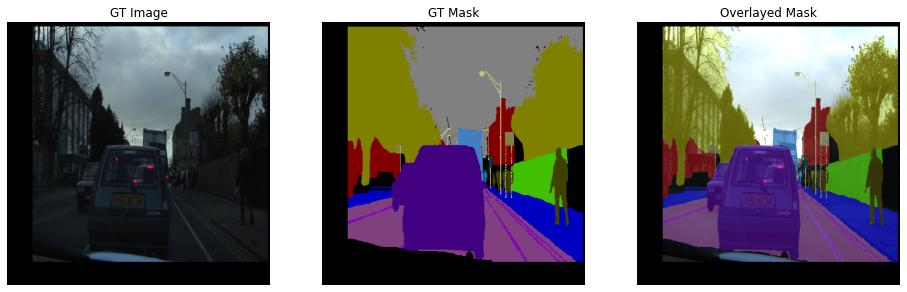

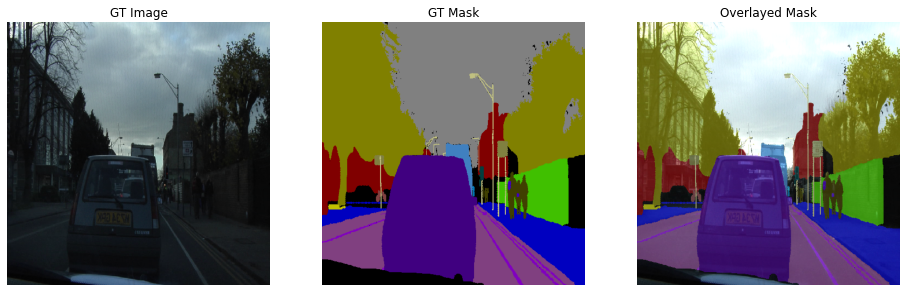

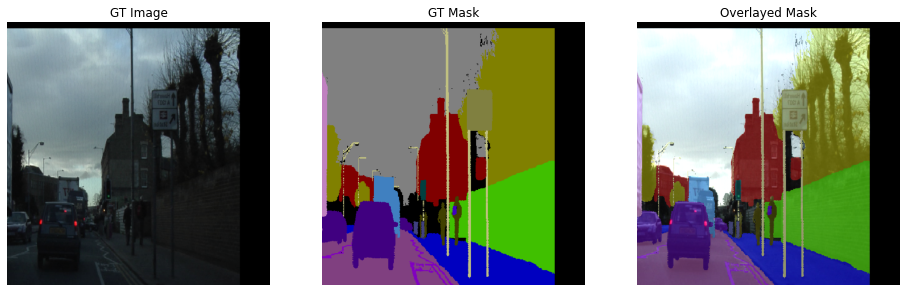

In [ ]:
for i, (images, masks) in enumerate(train_ds):
    if i == 3:
        break
    image, mask = images[0], masks[0]
    display_image_and_mask([image/255.0, mask], # Image and Mask in same pixel value range [0.0, 1.0] for display.
                           color_mask=True)

## 8 Custom Accuracy Metric

### 8.1 Mean IoU Metric

In [ ]:
def mean_iou(y_true, y_pred):
    """
    Arguments:
    y_true (ndarray or tensor): Ground truth mask (G). Shape: (batch_size, height, width)
                               Sparse representation of segmentation mask.

    y_pred (ndarray or tensor): Prediction (P) from the model with or without softmax.
                                Shape: (batch_size, height, width, num_classes).

    return (scalar): Classwise mean IoU Metric.
    """

    # Get total number of classes from model output.
    num_classes = y_pred.shape[-1]

    # Convert single channel (sparse) ground truth labels to one-hot encoding for metric computation.
    y_true = tf.one_hot(tf.cast(y_true, tf.int32), num_classes, axis=-1)

    # Convert multi-channel predicted output to one-hot encoded thresholded output for metric computation.
    y_pred = tf.one_hot(tf.math.argmax(y_pred, axis=-1), num_classes, axis=-1)

    # Axes corresponding to image width and height: [B, H, W, C].
    axes = (1, 2)

    # Intersection: |G ∩ P|. Shape: (batch_size, num_classes)
    intersection = tf.math.reduce_sum(y_true * y_pred, axis=axes)

    # Total Sum: |G| + |P|. Shape: (batch_size, num_classes)
    total = tf.math.reduce_sum(y_true, axis=axes) + tf.math.reduce_sum(y_pred, axis=axes)

    # Union: Shape: (batch_size, num_classes)
    union = total - intersection

    # Boolean (then converted to float) value for each class if it is present or not.
    # Shape: (batch_size, num_classes)
    is_class_present =  tf.cast(tf.math.not_equal(total, 0), dtype=tf.float32)

    # Sum along axis(1) to get number of classes in each image.
    # Shape: (batch_size,)
    num_classes_present = tf.math.reduce_sum(is_class_present, axis=1)

    # Here, we use tf.math.divide_no_nan() to prevent division by 0 (i.e., 0/0 = 0).
    # Shape: (batch_size, num_classes)
    iou = tf.math.divide_no_nan(intersection, union)

    # IoU per image. Average over the total number of classes present in y_true and y_pred.
    # Shape: (batch_size,)
    iou = tf.math.reduce_sum(iou, axis=1) / num_classes_present

    # Compute the mean across the batch axis. Shape: Scalar
    mean_iou = tf.math.reduce_mean(iou)

    return mean_iou

## 9 Custom Loss Function

### 9.1 Dice / CCE Loss

In [ ]:
def dice_coef_loss(y_true, y_pred):
    """
    Arguments:
    y_true (ndarray or tensor): Ground truth mask (G). Shape: (batch_size, height, width)
                                Sparse representation of segmentation mask.

    y_pred (ndarray or tensor): Softmax prediction (P) from the model.
                                Shape: (batch_size, height, width, num_classes).

    return (scalar): Loss
    """
    num_classes = y_pred.shape[-1]

    # Convert single channel ground truth labels to one-hot encoding for metric computation.
    y_true = tf.one_hot(tf.cast(y_true, tf.int32), num_classes, axis=-1)

    # Axes corresponding to image width and height: [B, H, W, C].
    axes = (1, 2)

    # Intersection: |G ∩ P|. Shape: (batch_size, num_classes)
    intersection = tf.math.reduce_sum(y_true * y_pred, axis=axes)

    # Total Sum: |G| + |P|. Shape: (batch_size, num_classes)
    total = tf.math.reduce_sum(y_true, axis=axes) + tf.math.reduce_sum(y_pred, axis=axes)

    # Dice coefficient. Shape: (batch_size, num_classes)
    eps = 1e-3
    dc = (2. *  intersection + eps) / (total + eps)

    # Compute the mean over the remaining axes (batch and classes).
    dc_mean = tf.math.reduce_mean(dc)

    # Compute cross-entropy loss.
    CCE =  tf.keras.losses.categorical_crossentropy(y_true, y_pred)

    return 1.0 - dc_mean + CCE

## 10 Compile and Train the Model

### 10.1 Adding Custom Metrics and Loss Functions

In [ ]:
model.compile(optimizer=Adam(learning_rate=TrainingConfig.LEARNING_RATE),
              loss=dice_coef_loss,
              metrics=['accuracy', mean_iou],
             )

### 10.2 Adding Model Checkpoint Callback

In the next code cell, we accomplish two important things. First, we create a new directory for the current training model checkpoint to be saved. This will ensure that the previous training checkpoints are not overwritten. We also create a `ModelCheckpoint` callback to save the best model according to the **highest validation mean IoU**. This will ensure that we don't need to manually monitor the training for the "best" model.

In [ ]:
# Create a new checkpoint directory every time.
if not os.path.exists(TrainingConfig.CHECKPOINT_DIR):
    os.makedirs(TrainingConfig.CHECKPOINT_DIR)

num_versions = len(os.listdir(TrainingConfig.CHECKPOINT_DIR)) + 1
version_dir = TrainingConfig.CHECKPOINT_DIR +'/version_' + str(num_versions)
os.makedirs(version_dir)

# Callback to save the best model based on validation loss.
model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(filepath=version_dir,
                                                               save_weights_only=False,
                                                               monitor='val_mean_iou',
                                                               mode='max',
                                                               save_best_only=True,
                                                              )

### 10.3 Train the Model

In [ ]:
history = model.fit(train_ds,
                    epochs=TrainingConfig.EPOCHS,
                    verbose=1,
                    validation_data=valid_ds,
                    workers=4,
                    use_multiprocessing=True,
                    callbacks=[model_checkpoint_callback],
                   )

Epoch 1/101
92/92 [==============================] - 100s 813ms/step - loss: 2.1669 - accuracy: 0.6979 - mean_iou: 0.1520 - val_loss: 2.6275 - val_accuracy: 0.6529 - val_mean_iou: 0.1568
Epoch 2/101
92/92 [==============================] - 77s 828ms/step - loss: 1.5141 - accuracy: 0.8292 - mean_iou: 0.2625 - val_loss: 1.5995 - val_accuracy: 0.8342 - val_mean_iou: 0.2804
Epoch 3/101
92/92 [==============================] - 79s 842ms/step - loss: 1.3499 - accuracy: 0.8600 - mean_iou: 0.3031 - val_loss: 1.3788 - val_accuracy: 0.8560 - val_mean_iou: 0.3176
Epoch 4/101
92/92 [==============================] - 78s 834ms/step - loss: 1.2485 - accuracy: 0.8765 - mean_iou: 0.3327 - val_loss: 1.3039 - val_accuracy: 0.8628 - val_mean_iou: 0.3377
Epoch 5/101
92/92 [==============================] - 79s 841ms/step - loss: 1.1743 - accuracy: 0.8891 - mean_iou: 0.3548 - val_loss: 1.2342 - val_accuracy: 0.8760 - val_mean_iou: 0.3626
Epoch 6/101
92/92 [==============================] - 78s 838ms/step -

## 11 Plot the Training Results

In [ ]:
def plot_results(metrics, ylabel=None, ylim=None, metric_name=None, color=None):

    fig, ax = plt.subplots(figsize=(18, 5))

    if not (isinstance(metric_name, list) or isinstance(metric_name, tuple)):
        metrics = [metrics,]
        metric_name = [metric_name,]

    for idx, metric in enumerate(metrics):
        ax.plot(metric, color=color[idx])

    plt.xlabel("Epoch")
    plt.ylabel(ylabel)
    plt.title(ylabel)
    plt.xlim([0, TrainingConfig.EPOCHS-1])
    plt.ylim(ylim)
    # Tailor x-axis tick marks
    ax.xaxis.set_major_locator(MultipleLocator(5))
    ax.xaxis.set_major_formatter(FormatStrFormatter('%d'))
    ax.xaxis.set_minor_locator(MultipleLocator(1))
    plt.grid(True)
    plt.legend(metric_name)
    plt.show(block=block_plot)
    plt.close()

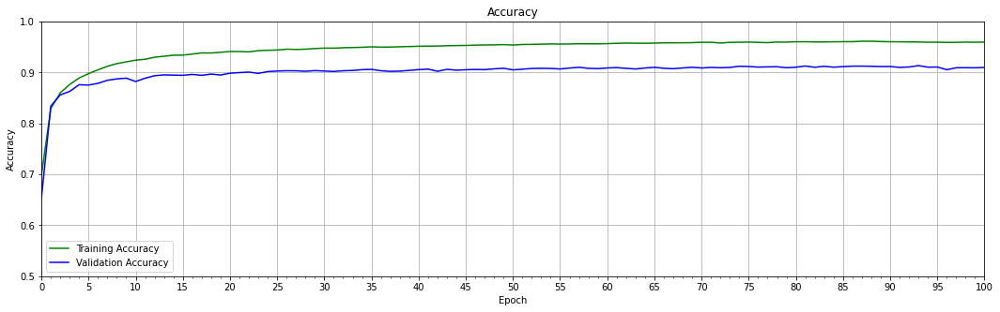

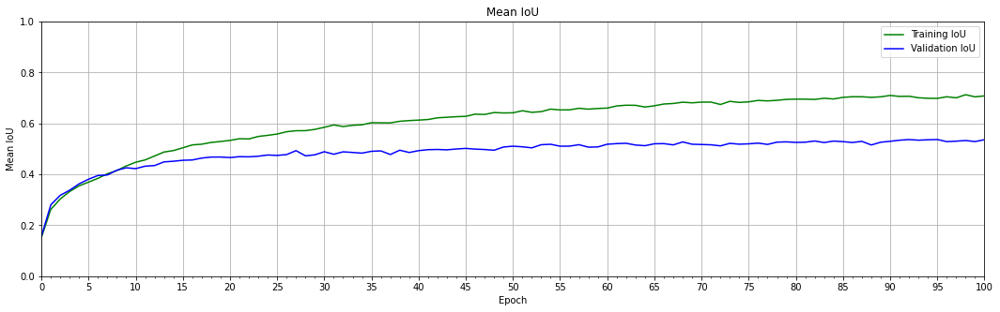

In [ ]:
# Pixel accuracy
train_acc = history.history["accuracy"]
valid_acc = history.history["val_accuracy"]

# Mean IoU.
train_iou = history.history["mean_iou"]
valid_iou = history.history["val_mean_iou"]


plot_results([ train_acc, valid_acc ],
            ylabel="Accuracy",
            ylim = [0.5, 1.0],
            metric_name=["Training Accuracy", "Validation Accuracy"],
            color=["g", "b"])

plot_results([ train_iou, valid_iou ],
            ylabel="Mean IoU",
            ylim = [0.0, 1.0],
            metric_name=["Training IoU", "Validation IoU"],
            color=["g", "b"])

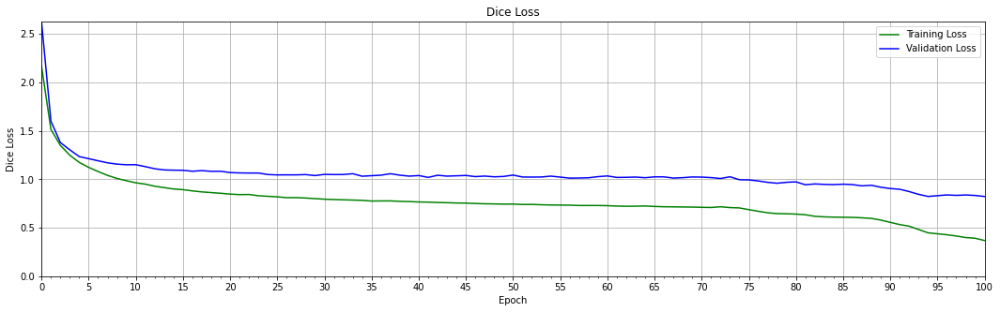

In [ ]:
train_loss = history.history["loss"]
valid_loss = history.history["val_loss"]


max_loss = max(max(train_loss), max(valid_loss))

plot_results([ train_loss, valid_loss ],
            ylabel="Dice Loss",
            ylim = [0.0, max_loss],
            metric_name=["Training Loss", "Validation Loss"],
            color=["g", "b"]);

## 12 Perform Inference

For inference, we will use the same validation data as we did during training. We will plot the ground truth images, the ground truth masks, and the predicted segmentation maps overlayed on the ground truth images.

### 12.1 Load the Trained Model

When loading the model, we need to specify the optional `custom_objects` dictionary mapping names (strings) to custom classes or functions to be considered during deserialization.


In [ ]:
trained_model = tf.keras.models.load_model(version_dir, custom_objects={'mean_iou':mean_iou,
                                                                        'dice_coef_loss':dice_coef_loss})

In [ ]:
evaluate = trained_model.evaluate(valid_ds)

print(f"Model evaluation accuracy:  {evaluate[1]*100.:.3f}")
print(f"Model evaluation IoU:       {evaluate[2]*100.:.3f}")

25/25 [==============================] - 40s 2s/step - loss: 0.8309 - accuracy: 0.9108 - mean_iou: 0.5368
Model evaluation accuracy:  91.075
Model evaluation IoU:       53.677


### 12.2 Inference

In [ ]:
def inference(model, dataset):

    num_batches_to_process = InferenceConfig.NUM_BATCHES

    for idx, data in enumerate(dataset):

        batch_img, batch_mask = data[0], data[1]
        pred_all = (model.predict(batch_img)).astype('float32')
        pred_all = pred_all.argmax(-1)
        batch_img = (batch_img).astype('uint8')
        if idx == num_batches_to_process:
            break

        for i in range(0, len(batch_img)):

            fig = plt.figure(figsize=(20, 8))

            # Display the original image.
            ax1 = fig.add_subplot(1,4,1)
            ax1.imshow(batch_img[i])
            ax1.title.set_text('Actual frame')
            plt.axis('off')

            # Display the ground truth mask.
            true_mask_rgb = num_to_rgb(batch_mask[i], color_map=id2color)
            ax2 = fig.add_subplot(1,4,2)
            ax2.set_title('Ground truth labels')
            ax2.imshow(true_mask_rgb)
            plt.axis('off')

            # Display the predicted segmentation mask.
            pred_mask_rgb = num_to_rgb(pred_all[i], color_map=id2color)
            ax3 = fig.add_subplot(1,4,3)
            ax3.set_title('Predicted labels')
            ax3.imshow(pred_mask_rgb)
            plt.axis('off')

            # Display the predicted segmentation mask overlayed on the original image.
            overlayed_image = image_overlay(batch_img[i], pred_mask_rgb)
            ax4 = fig.add_subplot(1,4,4)
            ax4.set_title('Overlayed image')
            ax4.imshow(overlayed_image)
            plt.axis('off')

            plt.show()

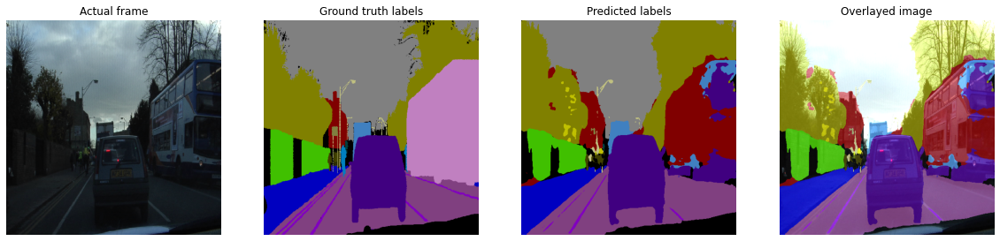

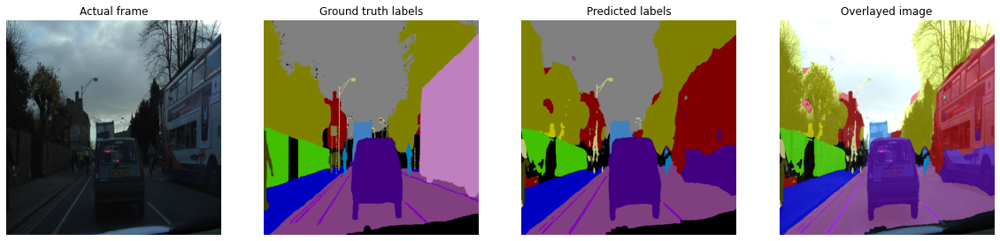

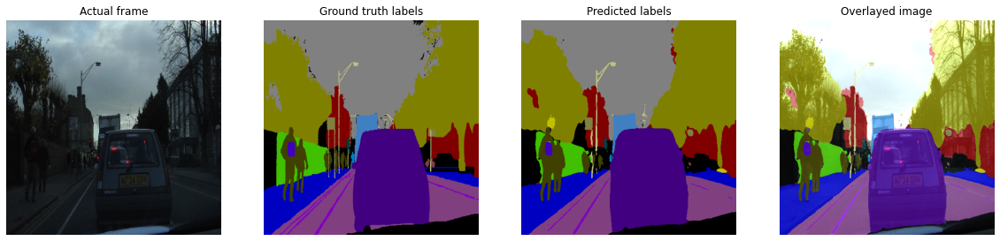

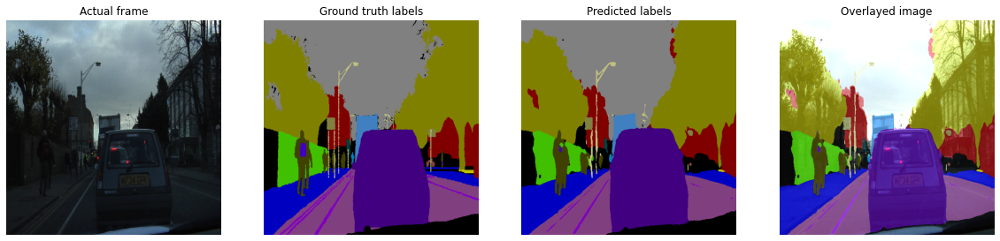

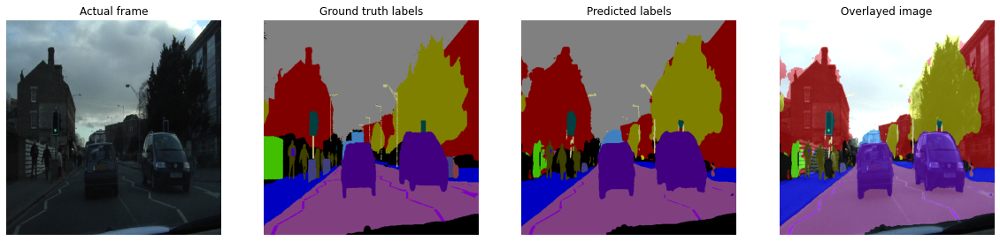

...

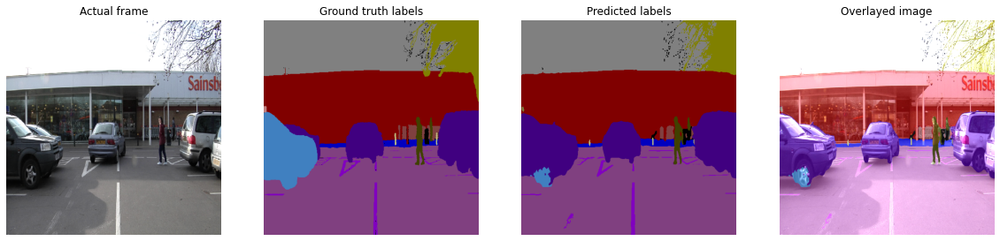

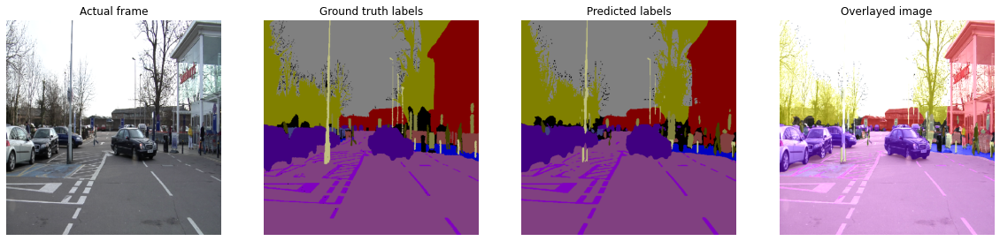

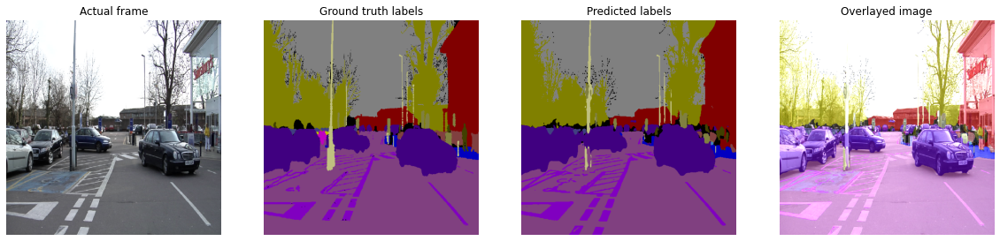

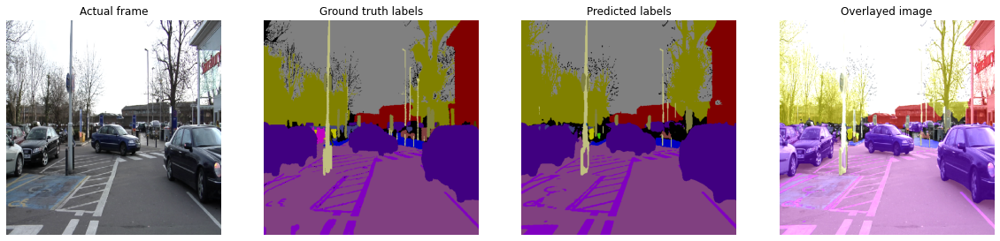

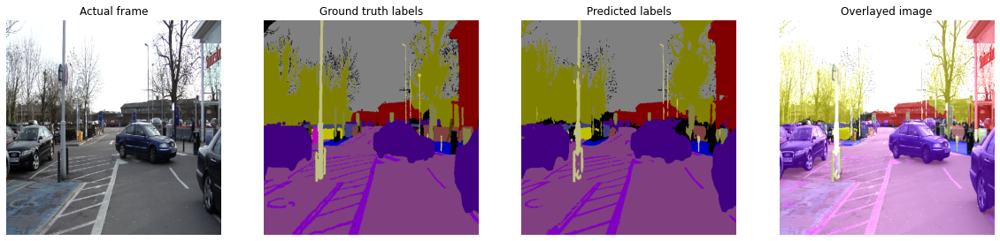

In [ ]:
inference(trained_model, valid_ds)

In [ ]:
def dir_inference(image_dir, mask_dir, trained_model, num_images_to_process=3):

    all_images = sorted(glob.glob(f"{image_dir}"))
    all_masks  = sorted(glob.glob(f"{mask_dir}"))

    num_frames_to_skip = 4

    num_images_to_process = min(num_images_to_process, len(all_images)/num_frames_to_skip)

    i = 0
    for k in range(num_images_to_process):

        i = i + num_frames_to_skip

        plt.figure(figsize=(18, 18))

        image = cv2.imread(all_images[i])
        mask  = cv2.imread(all_masks[i])

        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        mask  = cv2.cvtColor(mask, cv2.COLOR_BGR2RGB)

        orig_image = image.copy()
        h, w, _ = orig_image.shape

        image = cv2.resize(image, (DatasetConfig.IMG_HEIGHT, DatasetConfig.IMG_WIDTH))
        image = tf.convert_to_tensor(image, dtype=tf.float32)
        image = tf.expand_dims(image, axis=0)

        outputs = trained_model.predict(image)

        outputs = tf.squeeze(outputs, axis=0)
        outputs = np.array(outputs, dtype=np.float32)
        outputs_resized = cv2.resize(outputs, (w, h))
        rgb_outputs_resized = num_to_rgb(outputs_resized.argmax(-1), color_map=id2color)
        overlyed_image = image_overlay(orig_image, rgb_outputs_resized)

        plot_data = [orig_image, mask, rgb_outputs_resized]
        plt.imshow(overlyed_image)
        plt.axis('off')
        plt.show()

        plt.figure(figsize=(16, 8))

        for j in range(3):
            plt.subplot(1, 3, j+1)
            plt.imshow(plot_data[j])
            plt.axis('off')
            # Show the high resolution overlayed image only.
        plt.tight_layout()
        plt.show()

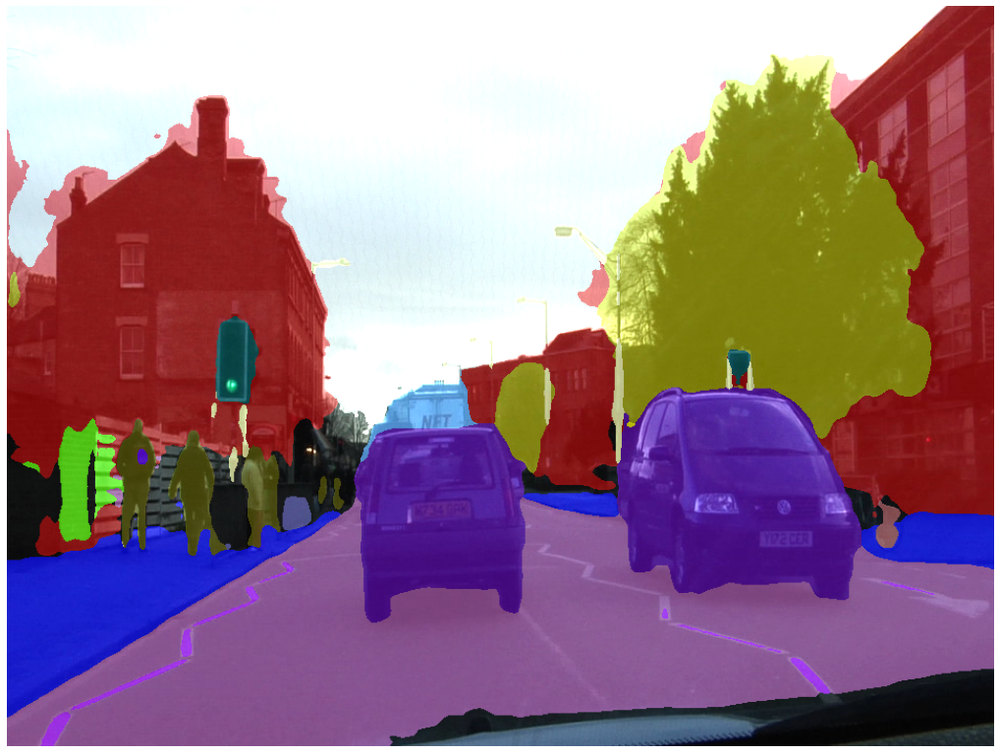

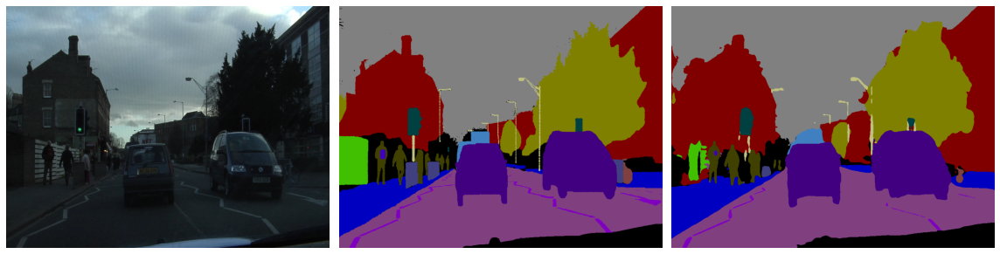

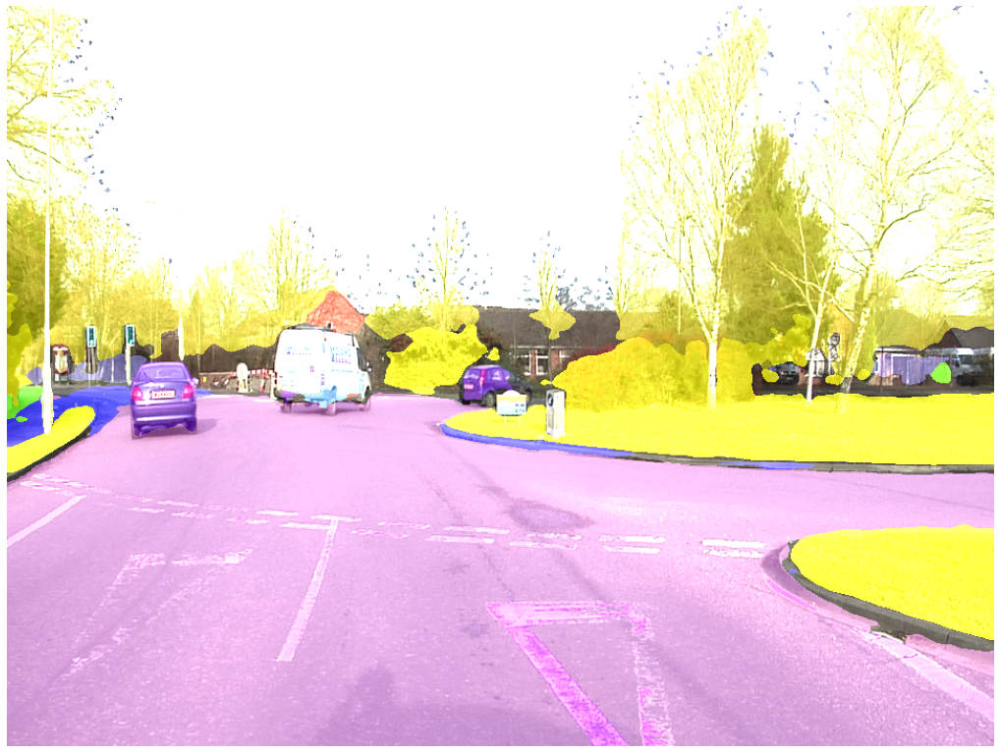

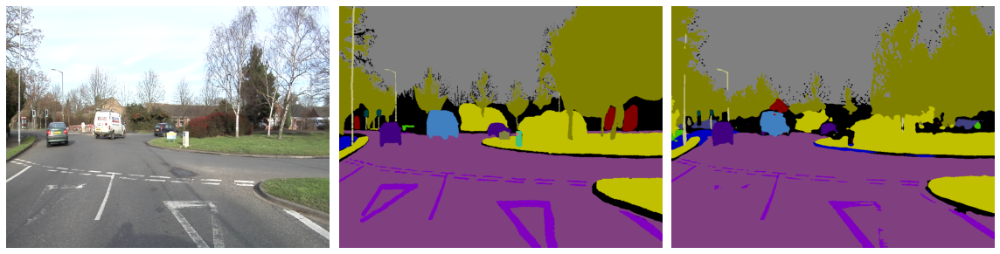

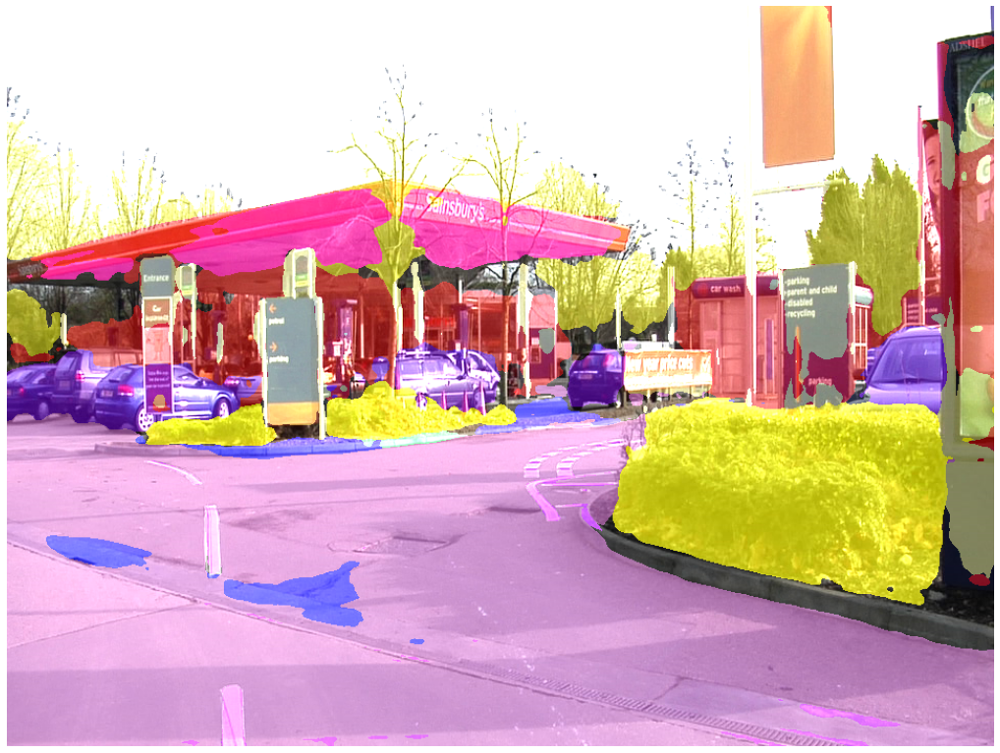

...

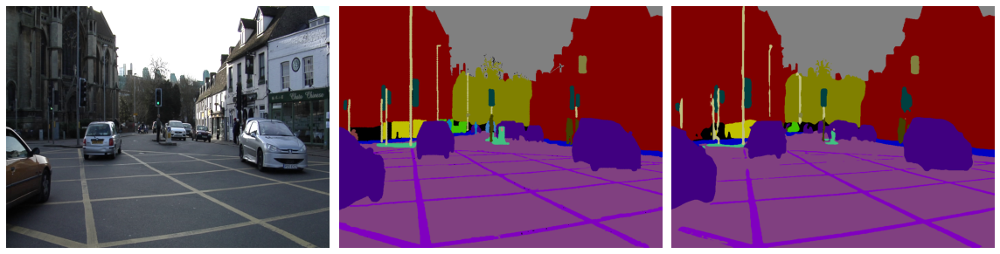

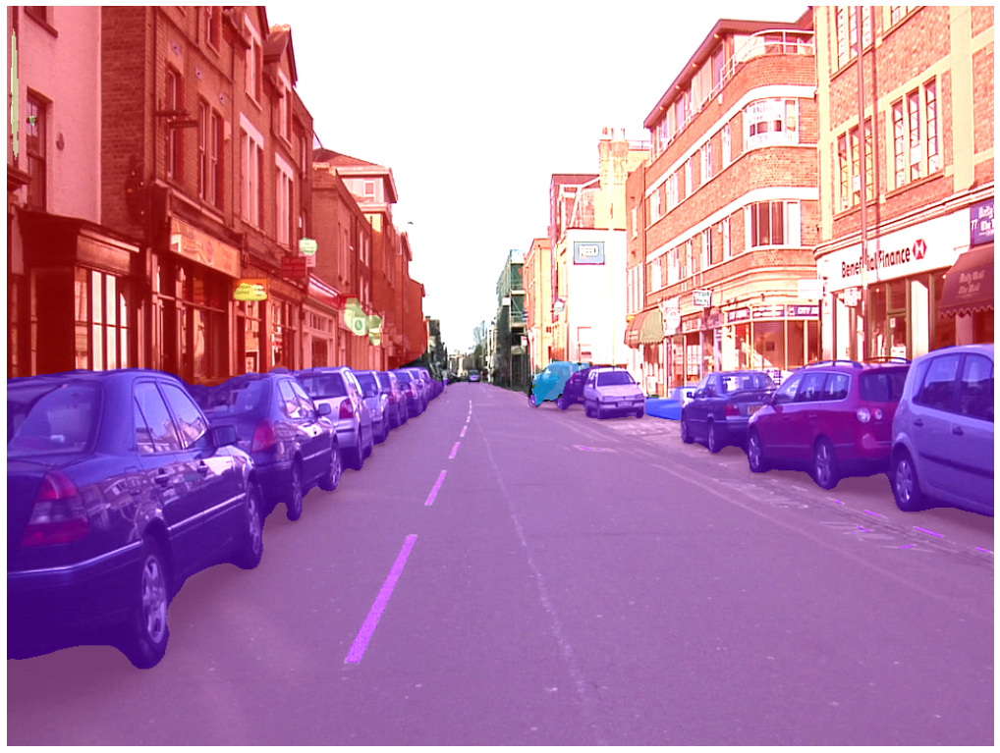

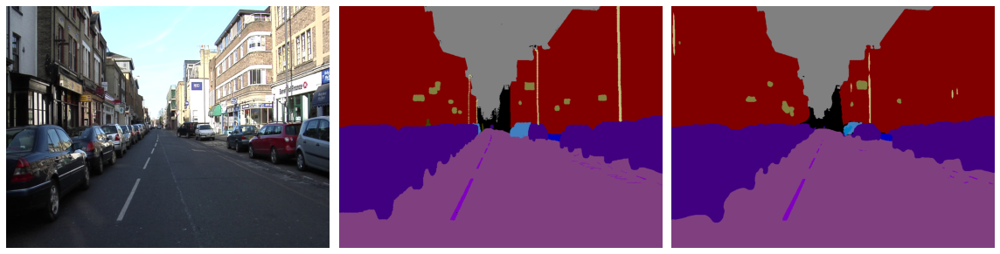

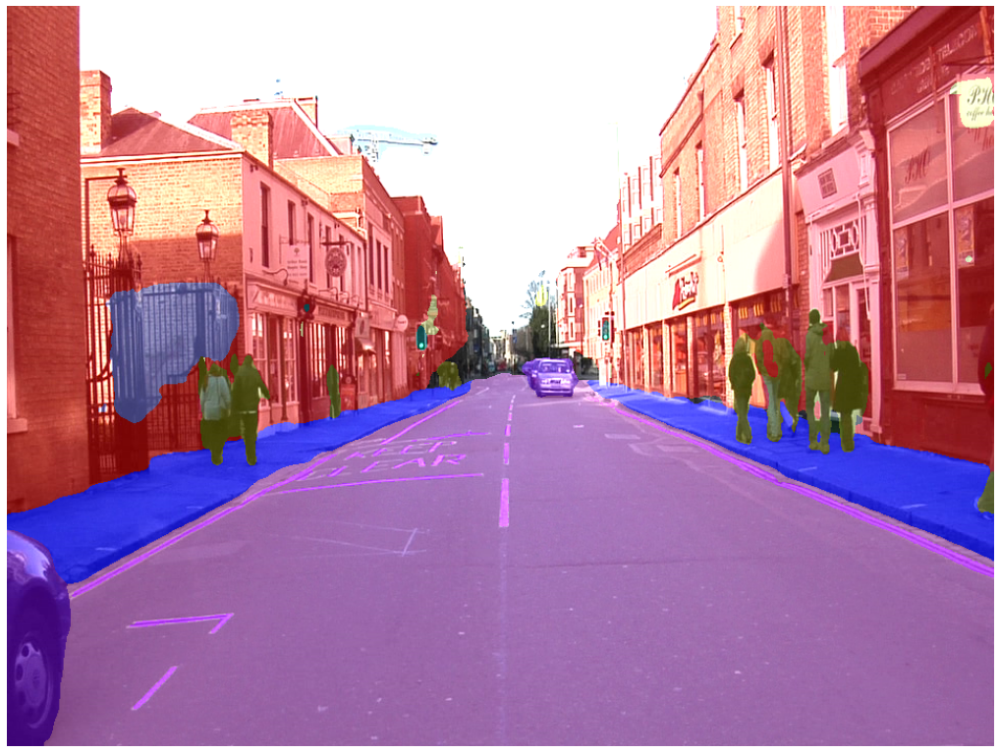

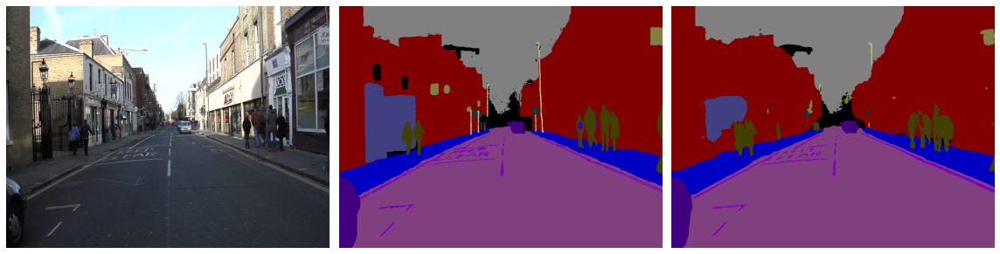

In [ ]:
dir_inference(DatasetConfig.DATA_VALID_IMAGES,
              DatasetConfig.DATA_VALID_LABELS,
              trained_model,
              num_images_to_process=12,
             )

## 13 Conclusion

In this notebook, we learned how to modify the DeepLabV3+ architecture and make other adjustments to improve the results by roughly 7% mean IoU compared to the baseline version of DeepLabV3+ from the previous notebook. The figures below show the predicted segmentation maps from all three models. The mean IoU for the validation dataset for all three models is also indicated. Notice that the modified DeepLabV3+ model has improved definition in several parts of the image, most notably the light posts (cream color) and the center traffic island (mint green).

<img src="https://opencv.org/wp-content/uploads/2022/07/c4-05-camvid-model-comparison.png" width=1000>

Remember, this is a very challenging dataset that contains 32 classes from real-world driving scenes. As you can see in the samples, many of the images have less than ideal lighting conditions, and many objects obscure other objects. Another reason this is a challenging dataset is due to its small size and the fact that many classes are underrepresented, which further reduces the number of samples that the model can learn from. Although data augmentation was used, better performance would likely be achieved if we had more data to train on.

If you want to experiment further, we suggest implementing this model using a different backbone. This will require a few code changes related to the specific layer you choose to extract from the backbone and would be a very good learning experience.